# Домашнее задание 

В этом задании мы попрактикуемся в методах снижения размерности и кластеризации данных. 

## Задание 1. Кластеризация типов движений (5 баллов)

В этой части задания мы будем работать с набором данных Samsung Human Activity Recognition. Набор данных заранее предобработан, если есть желание покопаться в исходнике, его легко нагуглить. Скачайте данные по ссылке ниже

https://drive.google.com/file/d/16ISu7lMumt5rbticbOggHMRjwTGBETtO/view?usp=sharing

Данные поступают с акселерометров и гироскопов мобильных телефонов Samsung Galaxy S2, также известен вид активности человека с телефоном в кармане – ходил ли он, стоял, лежал, сидел или шел вверх/вниз по лестнице.

Представим, что вид активности нам неизвестнен, и попробуем кластеризовать людей чисто на основе имеющихся признаков.

Также есть методичка/овервью от sklearn:
[Методичка](https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation)

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt


#plt.style.use(['seaborn-darkgrid'])
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams['figure.figsize'] = (12, 9)
plt.rcParams['font.family'] = 'DejaVu Sans'

%matplotlib inline
%config InlineBackend.figure_format="retina"

RANDOM_STATE = 42

import warnings
warnings.filterwarnings('ignore')

Matplotlib created a temporary cache directory at /var/folders/6p/bshr1_dj3_7_gk1krflr4lzm0000gn/T/matplotlib-hqz3uqtp because the default path (/Users/dan/.matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


### Задание 1.0 (0.1 балл)
Прочитайте данные из файлов и объедните тестовую и обучающие выборки.

В файлах ```..._labels``` лежат настоящие классы. Их также объедините, но в отдельную переменную (например ```y```). Данный вектор для кластеризации нам не нужен, но мы будем смотреть по нему метрики.

In [2]:
path = '/Users/dan/git_repo/movs/ml/ml/hometasks/HT5/data/'

X_test = np.loadtxt(path+'samsung_test.txt')
X_train = np.loadtxt(path+'samsung_train.txt')

y_test = pd.read_csv(path+'samsung_test_labels.txt')
y_train = pd.read_csv(path+'samsung_train_labels.txt')

X_test.shape, X_train.shape, y_test.shape, y_train.shape

((2947, 561), (7352, 561), (2946, 1), (7351, 1))

In [3]:
X = np.vstack((X_test, X_train))
y = np.vstack((y_test, y_train))

X.shape, y.shape

((10299, 561), (10297, 1))

Эти метки соответствуют:

1 - ходьбе,
2 - подъему вверх по лестнице,
3 - спуску по лестнице,
4 - сидению,
5 - стоянию,
6 - лежанию

### Задание 1.1 (0.5 баллов)

Отмасштабируйте выборку с помощью ```StandardScaler```.

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

In [4]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

### Задание 1.2 (0.6 баллов)

Мы не обсуждали методы понижения размерности, поэтому можно воспользоваться ими в качестве чёрного ящика. Если есть желание, можно почитать про PCA в [Конспекте](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture12-factorizations.pdf). Понизьте размерность с помощью ```PCA```, оставляя столько компонент, сколько нужно для того, чтобы объяснить как минимум 90% дисперсии отмасштабированных данных. Для этого сумма массива pca.explained_variance_ratio_ должна быть больше 0.9.  ```random_state``` используйте из объявленной в самом начале переменной ```RANDOM_STATE``` (42).

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)

In [5]:
from sklearn.decomposition import PCA

pca = PCA(random_state=RANDOM_STATE)
pca.fit(X_scaled)

# Определим компоненты, которые будем использовать
cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)
n_components = np.where(cumulative_explained_variance >= 0.9)[0][0] + 1

print(f'Возьмем {n_components} компонент')


Возьмем 65 компонент


In [6]:
# PCA с новым количеством компонент
pca = PCA(n_components=n_components, random_state=RANDOM_STATE)
reduced_data = pca.fit_transform(X_scaled)

idx_max_component = n_components - 1
print(f'Сохранённая дисперсия: {cumulative_explained_variance[idx_max_component]}')

reduced_data.shape, X_scaled.shape

Сохранённая дисперсия: 0.9004833346822932


((10299, 65), (10299, 561))

### Задание 1.3 (0.3 баллов)

Визуализируйте данные в проекции на первые две главные компоненты. Используйте ```cmap="virdis"``` или любой другой, с которым будет красиво :)

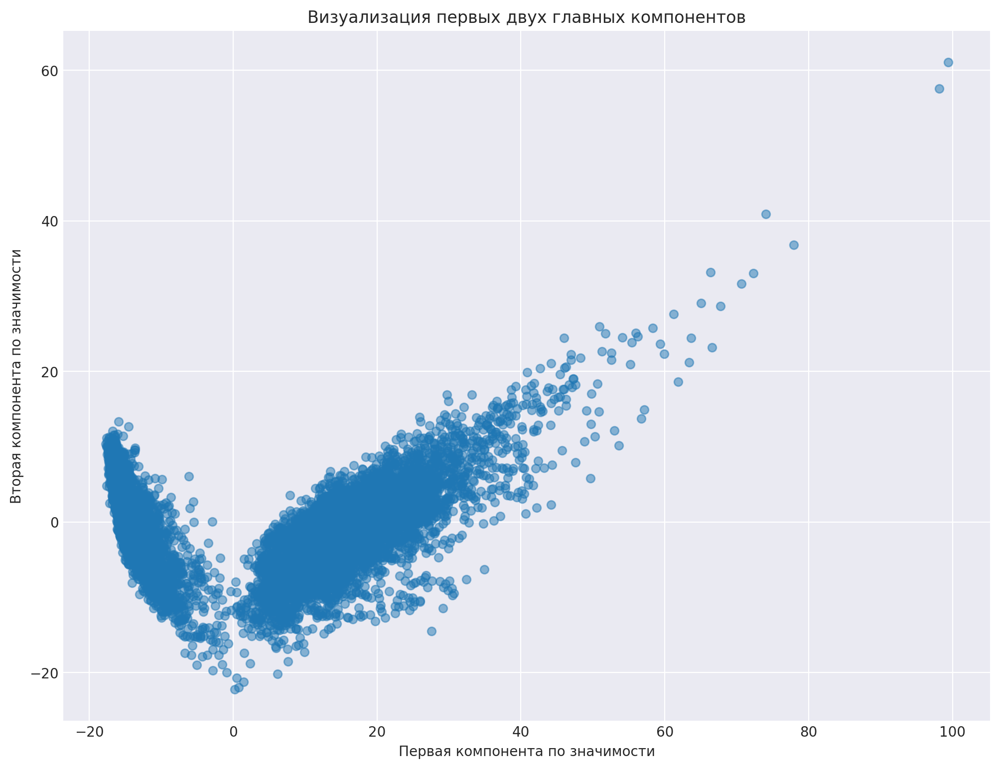

In [136]:
#your code here
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], cmap='viridis', alpha=0.5)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('Визуализация первых двух главных компонентов')

plt.show()

### Задание 1.4 (0.4 балла)

Сделайте кластеризацию данных методом ```KMeans```, обучив модель на данных со сниженной за счет ```PCA```
размерностью. В данном случае нужно искать 6 кластеров (изначально у нас 6 классов). Засеките время обучения и время инференса.

Параметры:

```n_clusters = 6``` (число уникальных меток целевого класса = 6)

```n_init = 100```

```random_state = RANDOM_STATE``` (для воспроизводимости результата, не забывайте указывать его и дальше!)

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)

In [4]:
from sklearn.cluster import KMeans

KM = KMeans(
    n_clusters=6,
    n_init=100,
    random_state=RANDOM_STATE
    )

In [125]:
%%time

# Обучение KM (1.7 с)
KM.fit(reduced_data)

CPU times: user 15.9 s, sys: 972 ms, total: 16.9 s
Wall time: 1.7 s


KMeans(n_clusters=6, n_init=100, random_state=42)

In [130]:
%%time

# Предсказание (4 мс)
pred_labels = KM.predict(reduced_data)

CPU times: user 6.52 ms, sys: 2.24 ms, total: 8.76 ms
Wall time: 4.09 ms


### Задание 1.5 (0.2 балла)

Визуализируйте данные в проекции на первые две главные компоненты. Раскрасьте точки в соответствии с полученными метками кластеров.

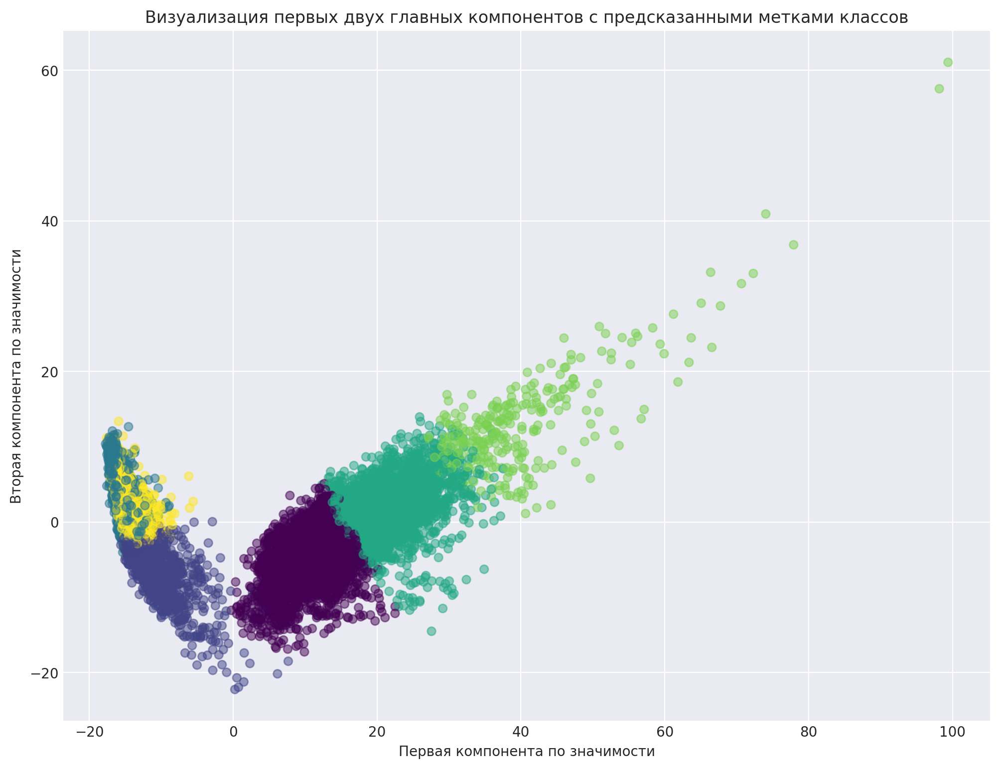

In [137]:
#your code here

plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=pred_labels, cmap='viridis', alpha=0.5)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('Визуализация первых двух главных компонентов с предсказанными метками классов')

plt.show()

### Задание 1.6 (0.3 баллов)

Выберите какие-то метрики (минимум две) из известных вам или из методички (ссылка в начале дз, пункт 2.3.10), объясните ваш выбор.

Выведите на экран значения метрик качества кластеризации и используйте их далее.

In [7]:
from sklearn.metrics import (
    silhouette_score, # В диапазоне от -1 до 1, хотим ближе к 1
    davies_bouldin_score # Чем скор больше - тем лучше
)

In [140]:
# Silhouette score

silhouette_avg = silhouette_score(reduced_data, KM.labels_)
print(f'Kmeans 6 clusters Silhouette_score = {silhouette_avg}')

Kmeans 6 clusters Silhouette_score = 0.1417945713127518


In [157]:
# Davies-Bouldin Index
dbi = davies_bouldin_score(reduced_data, KM.labels_)
print(f'Kmeans 6 clusters davies_bouldin_score = {dbi}')

Kmeans 6 clusters davies_bouldin_score = 2.0502233603416227


Для анализа качаства кластеризации я выбрал две метрики - метрика силуэта и Davies-Bouldin индекс

* метрика силуэта

Мой выбор пал на нее, так как я хотел оценить насколько образцы каждого кластера сходжи с остальными образцами кластеров. То есть насколько каждая точка отличается от других точек в своем кластере. 

Метрика для каждой точки рассчитывается как разность между средним расстоянием до ближайшего образца в том же кластере и средним расстоянием до ближайшего образца в другом кластере делённое на максимум из этих двух расстояний.

Коэфицент принимает значение от -1 до 1, где 1 - идеальное распределение, 0 - точки данных в одном кластере не очень различаются от точек в другом кластере, а -1 указывает на неправильную кластеризацию точек.

* Davies-Bouldin Index

Позволяет определить сходство каждого кластера с другим кластером, который больше всего похож на него. Сходство определяется как отношение между межкластерными и внутрикластерными расстояниями. Здесь моя идея заключалась в оценке разделение класторв

Ноль - это наименьший возможный балл. Значения, близкие к нулю, указывают на лучшее распределение.

**Основная идея**

Я хотел подобрать разные метрики для задачи кластеризации. Выбранный Davies-Bouldin Index сравнивает кластеры между собой, в то время как Silhouette Score сравнивает каждую точку данных с другими кластерами и своим собственным кластером.


### Задание 1.7 (0.8 баллов)
Теперь попробуем сделать кластеризацию с помощью ```AgglomerativeClustering```.

Вновь визуализируйте данные с раскраской по полученным меткам и выведите метрики. Засеките время обучения и время инференса. Сравните с ```KMeans```.

Ответьте на следующие вопросы:
* Стало ли лучше?
* Почему?

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html)

In [8]:
from sklearn.cluster import AgglomerativeClustering

#  Agglomerative Clustering
AC = AgglomerativeClustering(n_clusters=6)

In [9]:
%%time

# Обучение KMeans 1.7 s, Agglomerative 4.5 s
AC.fit(reduced_data)

CPU times: user 4.13 s, sys: 336 ms, total: 4.46 s
Wall time: 4.56 s


AgglomerativeClustering(n_clusters=6)

In [10]:
%%time

# Не имеет метода predict
# Предсказание KMeans 4ms, fit_predict Agglomerative Clustering 4.5s

preds_ac = AC.fit_predict(reduced_data)

CPU times: user 4.15 s, sys: 313 ms, total: 4.47 s
Wall time: 4.53 s


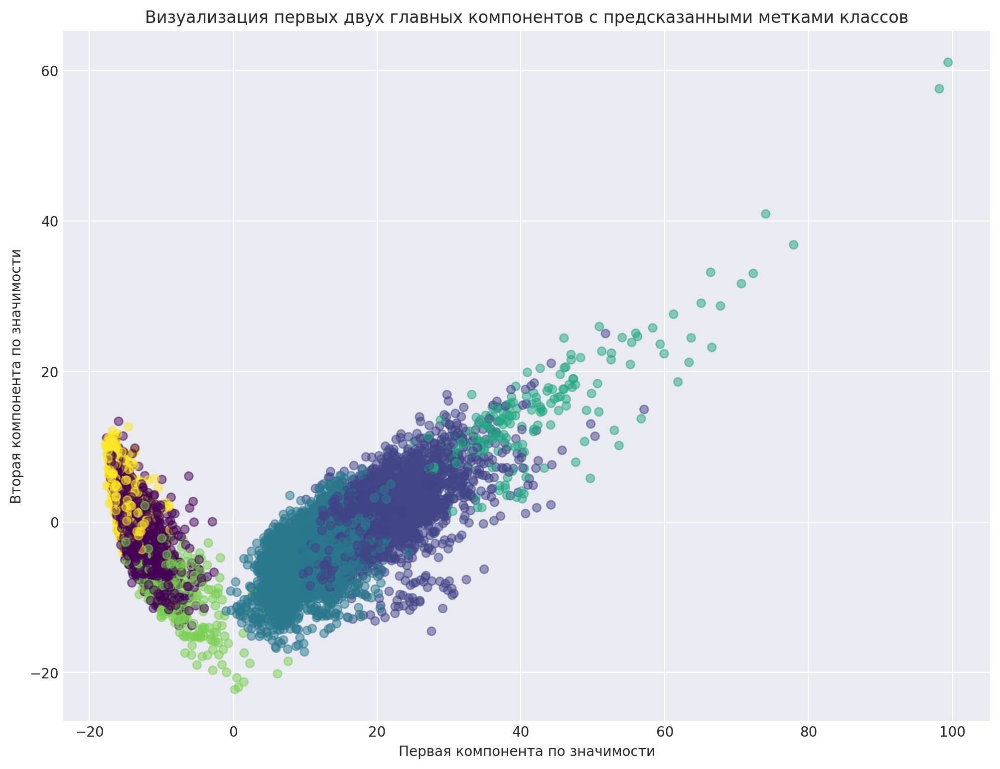

In [11]:
# График

plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=preds_ac, cmap='viridis', alpha=0.5)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('Визуализация первых двух главных компонентов с предсказанными метками классов')

plt.show()

In [12]:
# Silhouette score

silhouette_avg = silhouette_score(reduced_data, preds_ac)
print(f'AgglomerativeClustering 6 clusters Silhouette_score = {silhouette_avg}')

# Kmeans 6 clusters Silhouette_score = 0.1417945713127518


AgglomerativeClustering 6 clusters Silhouette_score = 0.14494373208163544


In [158]:
# Davies-Bouldin Index
dbi = davies_bouldin_score(reduced_data, preds_ac)
print(f'AgglomerativeClustering 6 clusters davies_bouldin_score = {dbi}')

# Kmeans 6 clusters davies_bouldin_score = 2.0502233603416227

AgglomerativeClustering 6 clusters davies_bouldin_score = 2.042030749783844


**Метрики качества**

Метрики показывают, что AgglomerativeClustering лучше справилось с задачей кластеризации (но изменения в 2-3 знаке после запятой). Визуально я, изначально, подумал, что качество даже упадет ввиду большей смешанности кластеров. Например фиолетовй класс возникает по середине бирюзового. Фиолетовый класс находится по середине желтового и тд.

**Почему AgglomerativeClustering оказался (ну почти) лучше**

Судя по первым двум компонентам - у нас не сферичиское распределение признаков, в котором алгоритм KMeans работает хуже ввиду своего алгоритма построения и поиска соседей при построении кластера, при этом Agglomerative Clustering может эффективно работать с кластерами, которые не являются сферическими. 

**Стоимость обучения и инференса**

AgglomerativeClustering требует больших вычислительных затрат - он обучается в 3 раза дольше, чем kmeans. Прямого сравнения по инференсу сделать не могу, так как AgglomerativeClustering не имеет predict метод, а только fit_predict - что означает сокрушительную победу KMeans, которая способна за очень малое время дредиктить метку класса, а AgglomerativeClustering в это время будет строить кластеры заново (5 сек)

### Задание 1.8 (0.8 баллов)

Попробуйте применить другие методы кластеризации из sklearn.  Засеките время обучения и время инференса. Также вычислите метрики качества, визуализируйте результаты, после чего сделайте вывод о том, какой метод сработал лучше.

In [299]:
from sklearn.cluster import kmeans_plusplus

___kmeans_plusplus___

In [168]:
%%time

# Использование kmeans_plusplus для инициализации центроидов
centers, indices = kmeans_plusplus(reduced_data, n_clusters=6, random_state=RANDOM_STATE)

CPU times: user 44.6 ms, sys: 8 ms, total: 52.6 ms
Wall time: 10.2 ms


In [169]:
# Объявим KMeans
kmeans_pp = KMeans(n_clusters=6, init=centers, n_init=1, max_iter=300, random_state=RANDOM_STATE)

In [170]:
%%time

# Обучение KMeans 1.7 s, Agglomerative 4.7 s, , KM_plus_plus total 45 ms


kmeans_pp.fit(reduced_data)

CPU times: user 103 ms, sys: 10.4 ms, total: 114 ms
Wall time: 33.3 ms


KMeans(init=array([[-1.50431090e+01,  1.68907296e+00,  2.79519439e+00,
        -4.30552718e+00, -4.17132272e+00,  1.12461205e+00,
        -1.75350176e+00, -4.85882843e-01, -2.85779855e+00,
         5.93585080e-01, -2.37530930e-01, -5.33660332e-01,
         3.57527800e-01,  1.10152484e-01, -2.38418396e+00,
         5.66457010e-01,  1.28268234e+00,  2.30273938e-01,
        -1.16040659e+00,  8.80821879e-01,  1.73395644e+00,
         7.898...
        -6.74897898e-01, -1.11398359e+00,  8.94418286e-02,
         8.00277662e-01, -1.20645890e+00, -1.16512849e+00,
        -9.52716003e-01, -5.28717830e-01, -4.02483799e-01,
         6.05645779e-01, -1.18897632e+00, -1.23678342e+00,
         7.77662258e-01,  1.47137900e-01,  4.94572021e-01,
        -7.46257883e-01, -2.47454641e-01,  6.72239794e-01,
         5.80996657e-01,  2.31573902e-01]]),
       n_clusters=6, n_init=1, random_state=42)

In [172]:
%%time

# Предсказание KMeans 4ms, fit_predict Agglomerative Clustering 5s, KM_plus_plus 4ms

km_pp_label = kmeans_pp.predict(reduced_data)

CPU times: user 6.98 ms, sys: 2.44 ms, total: 9.42 ms
Wall time: 3.75 ms


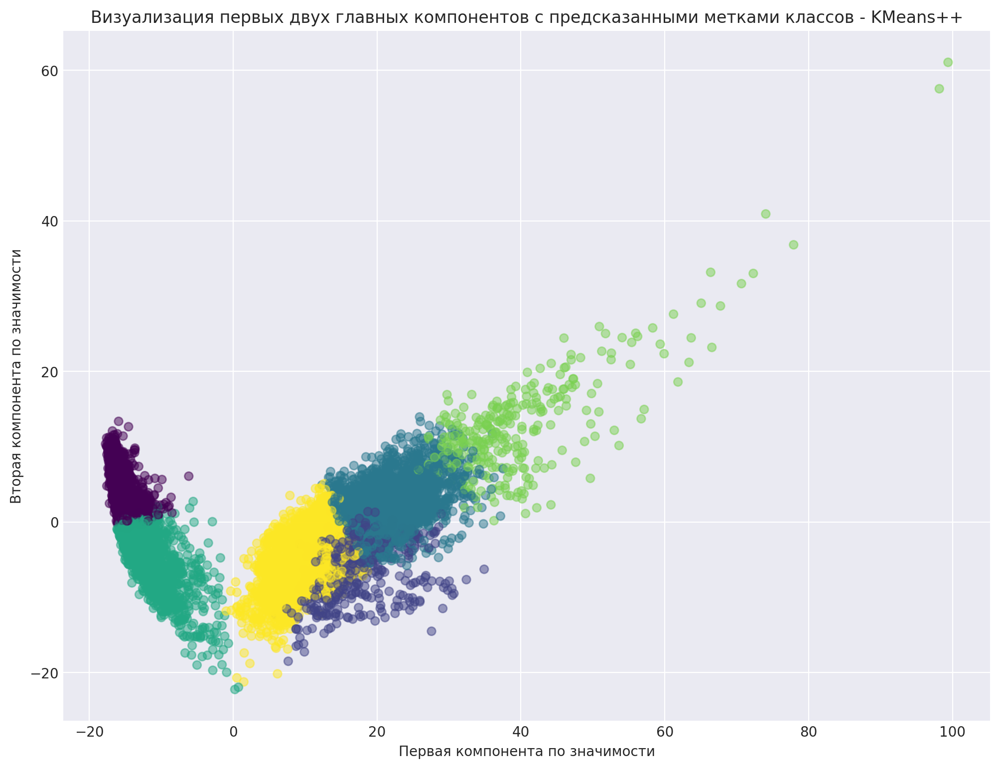

In [333]:
# График

plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=km_pp_label, cmap='viridis', alpha=0.5)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('Визуализация первых двух главных компонентов с предсказанными метками классов - KMeans++')

plt.show()

In [174]:
# Silhouette score

silhouette_avg = silhouette_score(reduced_data, km_pp_label)
print(f'Km_PP 6 clusters Silhouette_score = {silhouette_avg}')

# Kmeans 6 clusters Silhouette_score = 0.1417945713127518
# AgglomerativeClustering 6 clusters Silhouette_score = 0.14494373208163544
# Km_PP 6 clusters Silhouette_score = 0.1416610822636798

Km_PP 6 clusters Silhouette_score = 0.1416610822636798


In [176]:
# Davies-Bouldin Index
dbi = davies_bouldin_score(reduced_data, km_pp_label)
print(f'Km_PP 6 clusters davies_bouldin_score = {dbi}')

# Kmeans 6 clusters davies_bouldin_score = 2.0502233603416227
# AgglomerativeClustering 6 clusters davies_bouldin_score = 2.042030749783844
# Km_PP 6 clusters davies_bouldin_score = 2.236523462338897

Km_PP 6 clusters davies_bouldin_score = 2.236523462338897


___AffinityPropagation___

In [314]:
from sklearn.mixture import GaussianMixture

GM = GaussianMixture(n_components=6, random_state=RANDOM_STATE)

In [316]:
%%time

# Обучение KMeans 1.7 s, Agglomerative 4.7 s, KM_plus_plus total 45 ms, GaussianMixture 2.8 s

# Пример использования спектральной кластеризации
GM = GM.fit(reduced_data)

CPU times: user 17.5 s, sys: 2.15 s, total: 19.7 s
Wall time: 2.86 s


In [317]:
%%time

# Предсказание KMeans 4ms, fit_predict Agglomerative Clustering 5s, KM_plus_plus 4ms, GaussianMixture 51 ms

GM_labels = GM.predict(reduced_data)

CPU times: user 235 ms, sys: 32.5 ms, total: 267 ms
Wall time: 51.5 ms


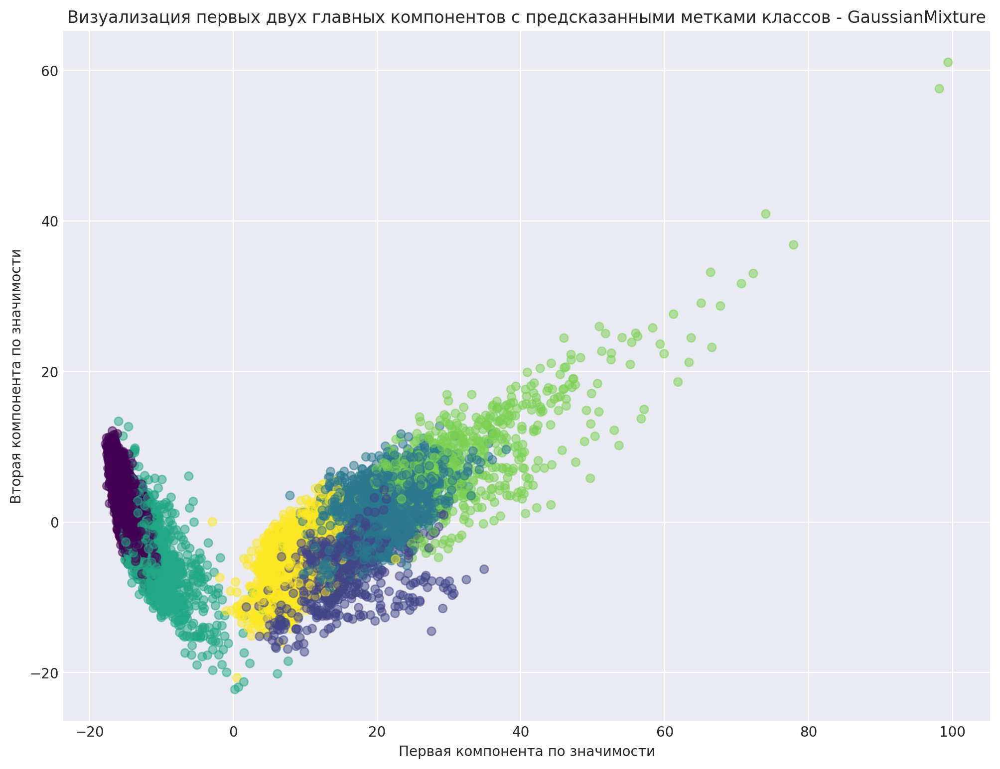

In [318]:
# График

plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=GM_labels, cmap='viridis', alpha=0.5)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('Визуализация первых двух главных компонентов с предсказанными метками классов - GaussianMixture')

plt.show()

In [319]:
# Silhouette score

silhouette_avg = silhouette_score(reduced_data, GM_labels)
print(f'GaussianMixture 6 clusters Silhouette_score = {silhouette_avg}')

# Kmeans 6 clusters Silhouette_score = 0.1417945713127518
# AgglomerativeClustering 6 clusters Silhouette_score = 0.14494373208163544
# Km_PP 6 clusters Silhouette_score = 0.1416610822636798
# GaussianMixture 6 clusters Silhouette_score = 0.14547973479851573

GaussianMixture 6 clusters Silhouette_score = 0.14547973479851573


In [320]:
# Davies-Bouldin Index
dbi = davies_bouldin_score(reduced_data, GM_labels)
print(f'GaussianMixture 6 clusters davies_bouldin_score = {dbi}')

# Kmeans 6 clusters davies_bouldin_score = 2.0502233603416227
# AgglomerativeClustering 6 clusters davies_bouldin_score = 2.042030749783844
# Km_PP 6 clusters davies_bouldin_score = 2.236523462338897
# GaussianMixture 6 clusters davies_bouldin_score = 2.5100973172347767

GaussianMixture 6 clusters davies_bouldin_score = 2.5100973172347767


___оценка___

Самым сильным алгоритмом по Silhouette score стал алгоритм GaussianMixture, kmeans самый слабый алгоритм (в том числе kmeans ++)

По Davies-Bouldin Index - лучший алгоритм AgglomerativeClustering, а результаты GaussianMixture наоборот показывает большое сходство между кластерами

Лучшим алгоритмом я назову агломеративную кластеризацию AgglomerativeClustering - основываясь на обоих метриках. Алгоритм разделил объекты так, что в сравнении с другими - кластеры не похоже друг на друга, при этом объекты кластеров схожи сильнее всех с остальными объекта кластера (в сравнении с другими алгоритмами) (Silhouette_score)

Что касается **времени на обучение и инференс** 

У AgglomerativeClustering нет метода predict, поэтому каждый раз для предсказаний необходимо заново прогонять все объекты через метод fit - в итоге инференс в 10ки раз больше других алгоритмов. Обучение так же в несколько раз дольше проходит по сравнению с другими алгоритмами. Лидер по времени - kmeans plus plus, предположу, что в этот алгоритм заложен мощный (качественный) и быстрый алгоритм поиска центроидов, отчего задача KMeans так же ставновится "дешевой" 

### Задание 1.9 (1 балл)
Для самой успешной из полученных кластеризаций попробуйте дать интерпретацию кластеров. Опишите характеристики объектов, попавших в каждый кластер. Для этого можете ответить на следующие вопросы:

* Похожи ли объекты внутри каждого кластера на определенный тип активности человека?
* В каких кластерах смешано несколько типов активности? С чем, на ваш взгляд, это может быть связано?
* Качественная ли получилась кластеризация? На основании чего вы можете сделать такой вывод?

In [225]:
# В X больше на 2 объекта и я буду исходить из того, что у нас не хватает двух объектов в Y и убдет достаточно отбросит 2 объекта из x
X.shape, y.shape

((10299, 561), (10297, 1))

___Сравним графики___

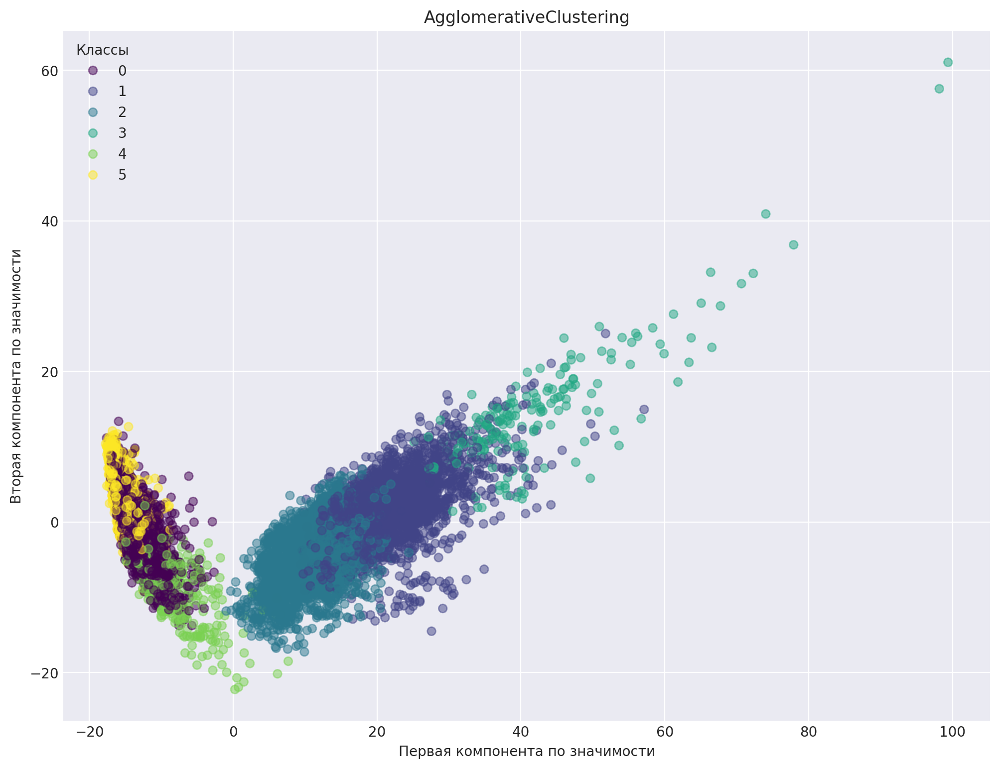

In [23]:
# График

scatter = plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=preds_ac, cmap='viridis', alpha=0.5)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('AgglomerativeClustering')

plt.legend(*scatter.legend_elements(), title="Классы")

plt.show()

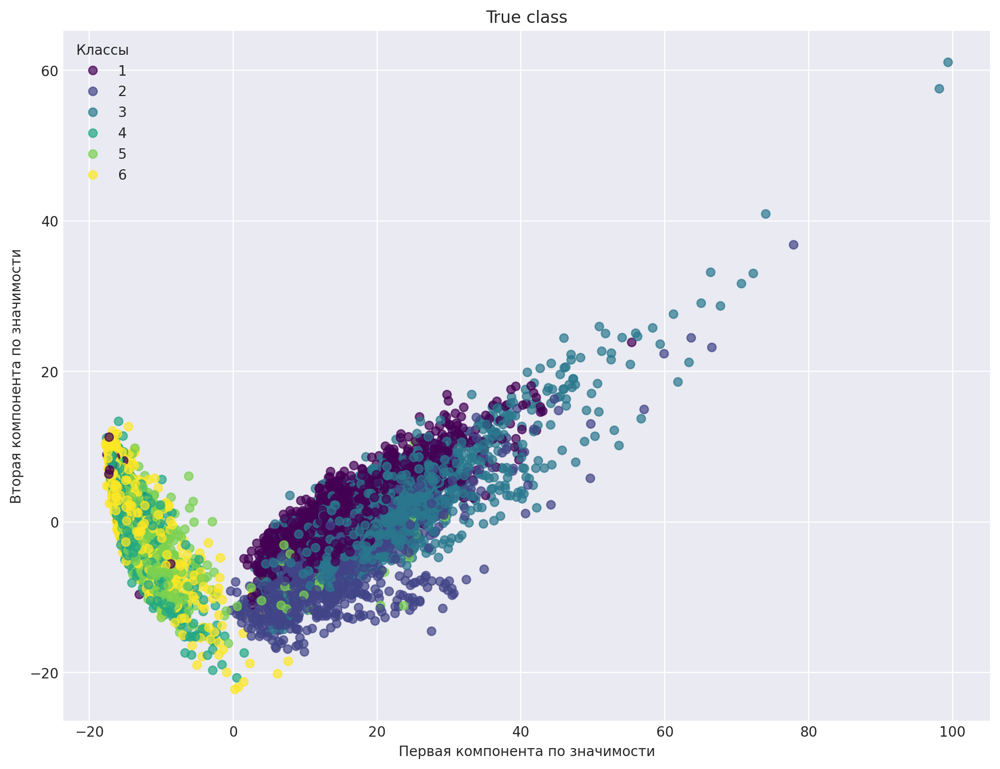

In [22]:
# График верных меток

scatter = plt.scatter(reduced_data[:-2, 0], reduced_data[:-2, 1], c=y[:,0], cmap='viridis', alpha=0.7)
plt.xlabel('Первая компонента по значимости')
plt.ylabel('Вторая компонента по значимости')
plt.title('True class')

plt.legend(*scatter.legend_elements(), title="Классы")

plt.show()

До применения GaussianMixture мне казалось, что мы плохо разделяем классы. 

Например в AgglomerativeClustering: действительные метки имеют вытянутое строение под углом 45 градусов, а мы предсказываем их вертикальными - совершая большое кол-во ошибок.

Gaussian Mixture Model же оказался способен определить более сложные кластеры, например фолетовый (темно синий на графике True class). Одноко он допустил большую ошибку

Кажется, что слева от нуля состояния покоя человека - сидя, стоя и лежа - они слабо различимы, наприимр желтый класс находится во всей области меньеш 0 по певой компоненте. Но  GaussianMixture увидел тут 2 класса, а 3 класса активностей разделил на 4.

___Табличное обоснование___

In [14]:
# распределение действительных классов
pd.Series(y[:,0]).value_counts()

6    1944
5    1904
4    1777
1    1722
2    1544
3    1406
Name: count, dtype: int64

In [16]:
# Соберу df для сравнения объектов 
t = pd.DataFrame({
    'true_class': y[:,0],
    'pred_class': preds_ac[:-2]
})

# Костыль для подсчета
t['cnt'] = 1

t_grouped = t.groupby(['true_class', 'pred_class'])['cnt'].count().reset_index()

t_grouped.head()

,true_class,pred_class,cnt
0,1,0,2
1,1,1,701
2,1,2,897
3,1,3,22
4,1,4,9


In [17]:
# Посмотрим какие метки даем каждому из классов

for label in t_grouped['true_class'].unique():

    display(t_grouped[t_grouped['true_class']==label].sort_values('cnt', ascending=False))

,true_class,pred_class,cnt
2,1,2,897
1,1,1,701
5,1,5,91
3,1,3,22
4,1,4,9
0,1,0,2


,true_class,pred_class,cnt
7,2,2,1201
6,2,1,322
8,2,3,21


,true_class,pred_class,cnt
9,3,1,1005
10,3,2,267
11,3,3,134


,true_class,pred_class,cnt
12,4,0,1651
13,4,4,85
14,4,5,41


,true_class,pred_class,cnt
15,5,0,1762
17,5,2,74
19,5,4,42
16,5,1,25
18,5,3,1


,true_class,pred_class,cnt
22,6,5,1486
21,6,4,287
20,6,0,171


Эти метки соответствуют:

1 - ходьбе,
2 - подъему вверх по лестнице,
3 - спуску по лестнице,
4 - сидению,
5 - стоянию,
6 - лежанию

Метки классов в pred_class перепутаны

*1 - хотьба*

Большинство отдано 2 и 5

*2 - подъем вверх по лестнице*

Большинство отдано 5 и 1

*3 - спуск по лестнице*

Большинство отдано 2 и 4

*4 - сидение*

Большинство отдано 0

*5 - стояние* 

Большиснтво отдано 0

*6 - лежание*

Большиство отдано 0

Активности наъодятся в классах 1,2 (3) и предсказанные метки для активностях не предсказываются для покоя (классы 4,5,6)

В итоге я бы отметил важные факторы: 
* алгоритм уверенно отделяет движение от покоя
* алгоритм способен выделять 80% активностей "подъема по лестнице" в одном класе, но в него же попадает много "ходьбы" - возможно эти примеры соответсвуют "быстрой ходьбе" :)
* Хорошо выделен спуск по лестнице (относительно, конечно же)
* алгоритм хорошо отделяет "лежание" от других состояний, однако сидение и стояние, фактически, объединены в один кластер

*Качественная ли получилась кластеризация? На основании чего вы можете сделать такой вывод?*

Я думаю, что мы можем хорошо различать активное состояние человека и бездействие. При этом разбивая эти 2 состояния на более мелкие классы - мы совершаем много ошибок.

Если привести практический пример - в задаче подсчета каллорий мы практически не будем делать грубые ошибки (считать что сжигаем калории, когда человек безддействует), сможем хорошо отделять подъем по лестнице (сильно затратный вид активности) и "сжигать больше каллорий в счетчике", но сюда же попадет и "ходьба". Так же можно было бы внедрить функцию "Вам пора подвигаться" - так как мы разделяем состояние бездействия от активной фазы и можем не тревожить человека, который спит (лежит)

## Задание 2. Разделение изображения на семантические компоненты (5 баллов)

![RedPanda](http://imgur.com/6Aa52Lm.png)

Алгоритмы кластеризации могут применяться в самых разных задачах. Например, в анализе изображений есть задача разделения изображения на семантические компоненты, которую можно решать в том числе с помощью алгоритмов кластеризации. 

Проверим их на ```duck.jpg``` и ```owls.jpg```

### Задание 2.0 (0.1 балл)

Откройте изображения, после чего визуализируйте их с помощью ```plt.imshow()```

In [2]:
import cv2

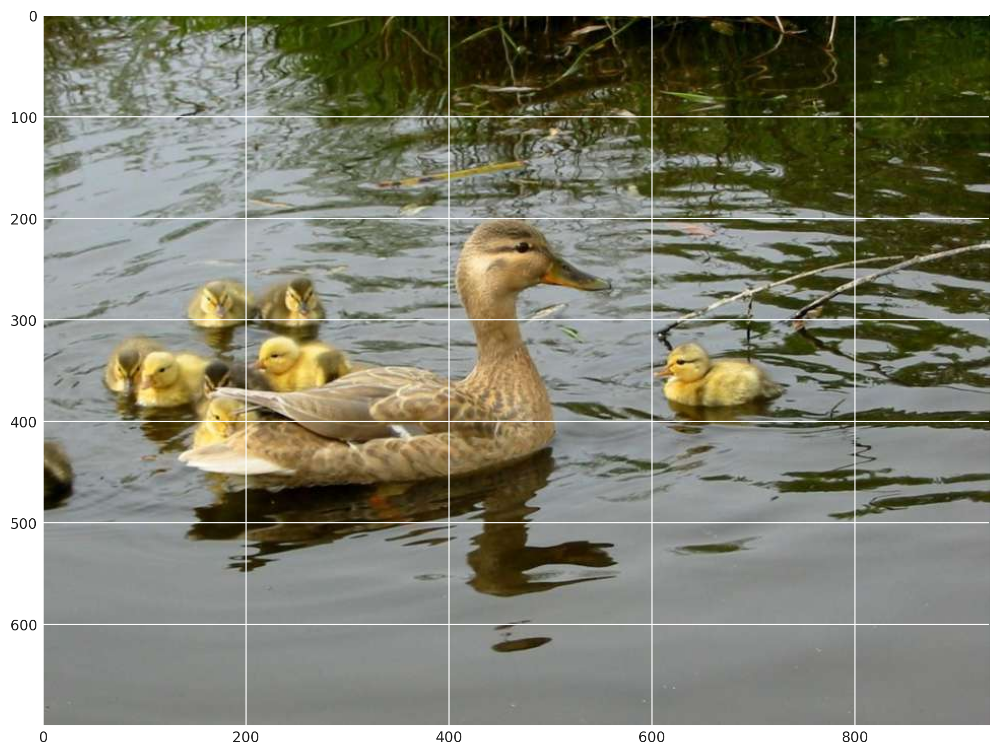

In [3]:
duck = cv2.imread("/Users/dan/git_repo/movs/ml/ml/hometasks/HT5/Duck.jpg")

# Преобразование изображения из BGR в RGB
duck_rgb = cv2.cvtColor(duck, cv2.COLOR_BGR2RGB)

plt.imshow(duck_rgb)

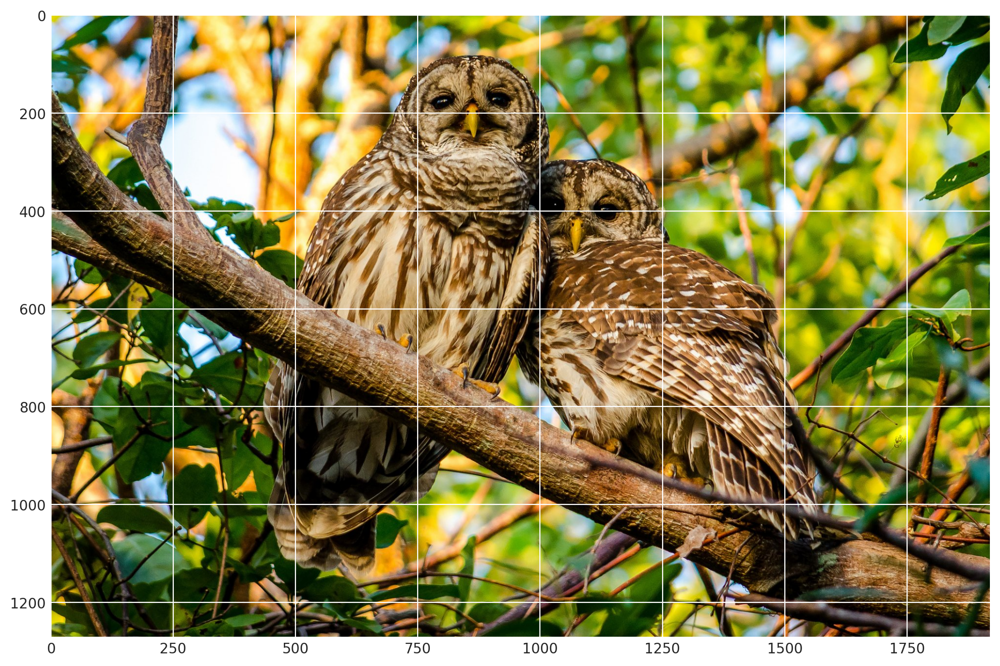

In [4]:
owls = cv2.imread("/Users/dan/git_repo/movs/ml/ml/hometasks/HT5/Owls.jpg")

# Преобразование изображения из BGR в RGB
owls_rgb = cv2.cvtColor(owls, cv2.COLOR_BGR2RGB)

plt.imshow(owls_rgb)

### Задание 2.1 (1.5 балла)
Для каждого изображения, используя кластеризацию ```KMeans```, выделите компоненты, охарактеризовав каждый пиксель следующим образом: $\psi_i = [\lambda x_i, \lambda y_i, r_i, g_i, b_i]$, где 
$x_i$ и $y_i$ — координаты пикселя, $r_i, g_i, b_i$ — его цвет, $\lambda$ — параметр, выражающий важность пространственной связности перед цветовой похожестью.

Примените полученную функцию, взяв следующие $\lambda$: 0.3 и 1.5 для ```duck.jpg``` и ```owls.jpg``` (или другие, но тогда с вас красивые результаты :) )

Число кластеров подберите разумным образом на свой вкус (в качестве нулевого приближения можно взять 3)

In [7]:
def find_components(image, lmbd, n_clusters):
    height, width, _ = image.shape

    # тут будем хранить вектора с значением пикселей
    vectors_pixels = np.zeros((height * width, 5), dtype=np.float32)

    # Заполнение массива векторами признаков
    for y in range(height):
        for x in range(width):
            r, g, b = image[y, x]
            vectors_pixels[y * width + x] = [lmbd * x / width, lmbd * y / height, r / 255, g / 255, b / 255]

    # KMeans - поулим метки кластера для каждого пикселя используя vectors_pixels
    KM = KMeans(n_clusters=n_clusters, random_state=0).fit(vectors_pixels)
    labels = KM.labels_

    # Создание сегментированного изображения
    image_return = np.zeros(image.shape, dtype=np.uint8)
    
    for i, label in enumerate(labels):

        # Извлечение цветовых компонентов из центров кластеров
        r, g, b = KM.cluster_centers_[label][2:] * 255
        image_return[i // width, i % width] = [int(r), int(g), int(b)]

    return image_return

Фотки ниже по заданию визуализирую, тут подбираю кластеры для уток и улитки

In [9]:
# lambda 1.5, clusters = 3
owls_1p5_k3 = find_components(owls_rgb, 1.5, 3)

In [10]:
# lambda 1.5, clusters = 6
owls_1p5_k6 = find_components(owls_rgb, 1.5, 6)

In [11]:
# lambda 0.3, clusters = 3

duck_0p3_k3 = find_components(duck_rgb, 0.3, 3)

In [12]:
# lambda 0.3, clusters = 100

duck_0p3_k20 = find_components(duck_rgb, 0.3, 15)

### Задание 2.2 (1.5 балла)
Попробуйте выделить сегменты при помощи [спектральной кластеризации](http://scikit-learn.org/stable/modules/clustering.html#spectral-clustering). Обратите внимание на [пример в sklearn](http://scikit-learn.org/0.16/auto_examples/cluster/plot_lena_segmentation.html). Для ускорения работы алгоритма рекомендуется привести изображение к серому цвету. При необходимости можно сжать изображения в 2 раза.

Подсказка: ```skimage``` с его ```color``` и ```transform``` в этом помогут :)

Или же воспользуйтесь аналогичными средствами ```PIL``` или ```cv2``` 

In [25]:
! pip install pyamg

In [15]:
from sklearn.cluster import SpectralClustering

___Переведем в серое___

Сова с размерностью 0.3 от исходной (чб)

In [9]:
# Сделаем картинку серой
gray_owls = cv2.cvtColor(owls_rgb, cv2.COLOR_BGR2GRAY)

# Снижу размерность на 70%
small_gray_owls = cv2.resize(gray_owls, (0, 0), fx=0.3, fy=0.3)

Утка с размерностью 0.3 от исходной (чб)

In [10]:
# Сделаем картинку серой
gray_duck = cv2.cvtColor(duck_rgb, cv2.COLOR_BGR2GRAY)

# Снижу размерность на 70%
small_gray_duck = cv2.resize(gray_duck, (0, 0), fx=0.3, fy=0.3)

Мой алгоритм сегментации изображения с помощью спектральной кластеризации

In [13]:
def spectral_segmentation(image, n_clusters, lmbd, beta, eps):
    # Черно белая - 2 размерности, не 3
    height, width = image.shape

    # тут будем хранить вектора с значением пикселей
    vectors_pixels = np.zeros((height * width, 2), dtype=np.float32)

    # Заполнение массива векторами признаков
    for y in range(height):
        for x in range(width):
            intensity = image[y, x]
            vectors_pixels[y * width + x] = [lmbd * x / width, lmbd * y / height]

    # SpectralClustering - поулим метки кластера для каждого пикселя используя vectors_pixels
    SC = SpectralClustering(n_clusters=n_clusters, random_state=RANDOM_STATE, eigen_solver='amg', gamma=beta, n_neighbors=eps)
    labels = SC.fit_predict(vectors_pixels)

    # Создание сегментированного изображения
    image_return = np.zeros(image.shape, dtype=np.uint8)
    
    for i, label in enumerate(labels):
            # Присвоение цвета пикселю на основе его метки кластера
            image_return[i // width, i % width] = label * 255 // n_clusters



    return image_return


С воиспроизведением этой функции возникли сложности - сначала я пробовал без снижения размерности и приведение к ЧБ формату

In [13]:
ducks_sp_segm = spectral_segmentation(duck_rgb, 3, 0.3, 1, 10)
#Cannot execute code, session has been disposed. Please try restarting the Kernel.

: 

In [16]:
owls_g_sp_segm_3 = spectral_segmentation(gray_owls, 3, 1.5, 1, 10)
# The Kernel crashed while executing code in the the current cell or a previous cell. Please review the code in the cell(s) to identify a possible cause of the failure. Click here for more info. View Jupyter log for further details.

: 

___ЧБ формат с сниженной размерностью на 70%___

In [44]:
# тут утки в черно белом формате, где размерность снижена на 70% раза - 100+ минут потребовалось, в итоге так же перезапуск ядра 
ducks_sp_segm_3 = spectral_segmentation(small_gray_duck, 3, 0.3, 1, 10)

___ЧБ формат с сниженной размерностью на 90%___

In [21]:
# Исходная картинка с утками (чб, 0.1 от исходной размерности)
small_gray_duck = cv2.resize(gray_duck, (0, 0), fx=0.1, fy=0.1)

plt.imshow(small_gray_duck)

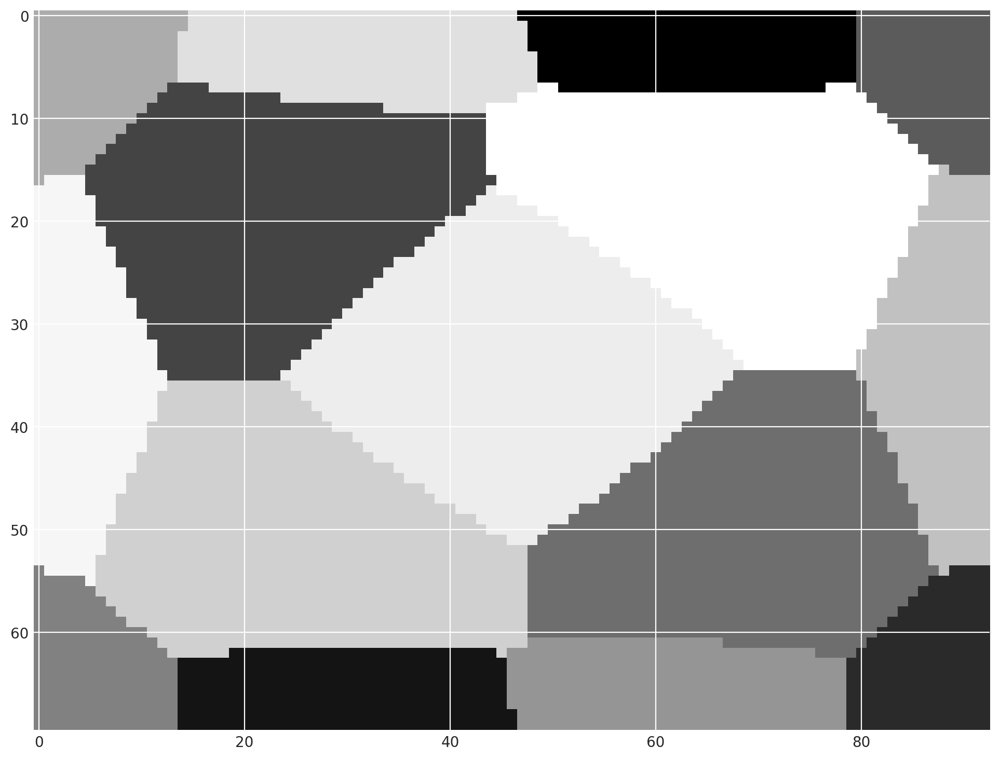

In [28]:
# 15 кластеров

ducks_sp_segm_3 = spectral_segmentation(small_gray_duck, 15, 1.5, 1, 10)
plt.imshow(ducks_sp_segm_3)

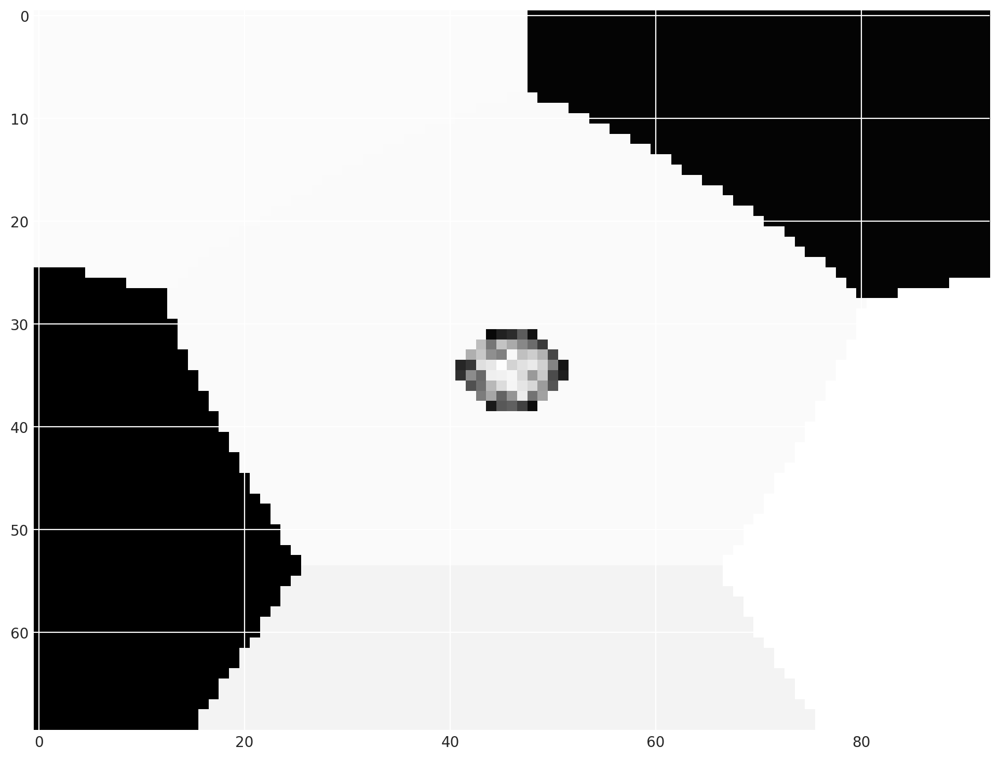

In [27]:
# 70 кластеров 

ducks_sp_segm_20 = spectral_segmentation(small_gray_duck, 70, 0.3, 1, 10)
plt.imshow(ducks_sp_segm_20)

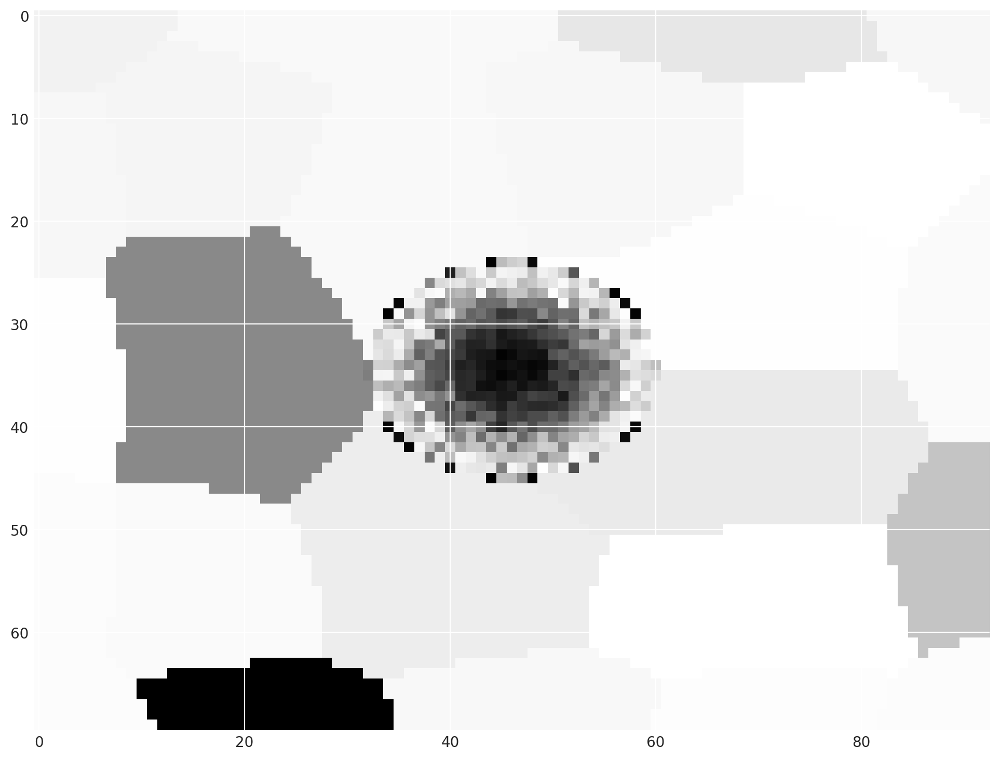

In [30]:
# 100 кластеров

ducks_sp_segm_3 = spectral_segmentation(small_gray_duck, 500, 1.5, 2, 10)
plt.imshow(ducks_sp_segm_3)

Что то не то

### Задание 2.3 (0.9 баллов)
Визуализируйте результаты сегментации (аналогично рисунку в начале задания 2) для обоих методов.

Реализованно только для KMeans

___KMeans clustering___

* Owls, lambda = 1.5

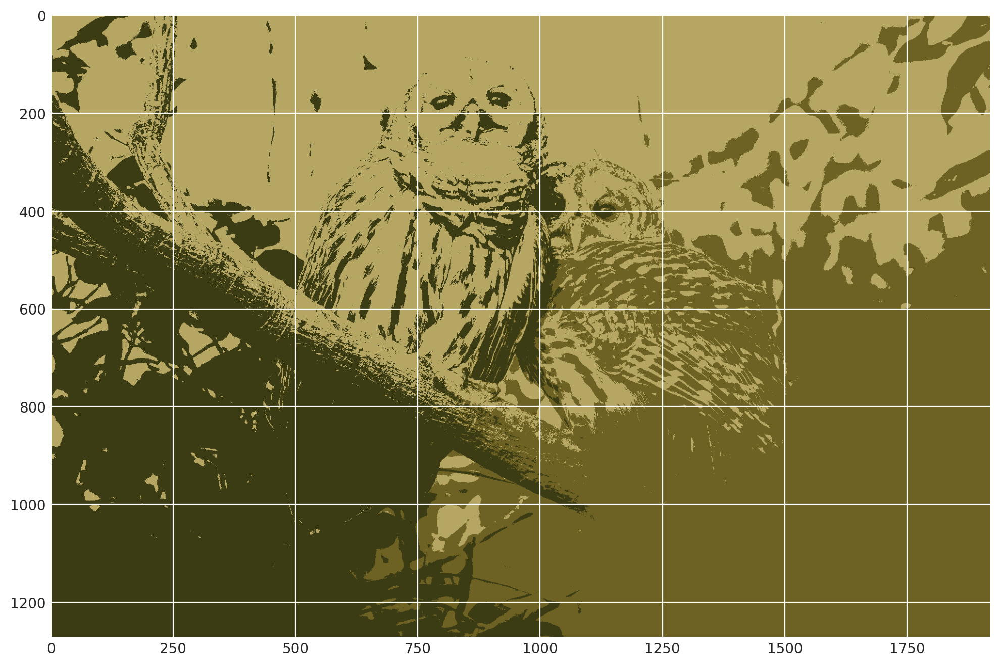

In [21]:
# 3 кластера - качество изображение размытое, но очертание прослеживаются

plt.imshow(owls_1p5_k3)
plt.show()

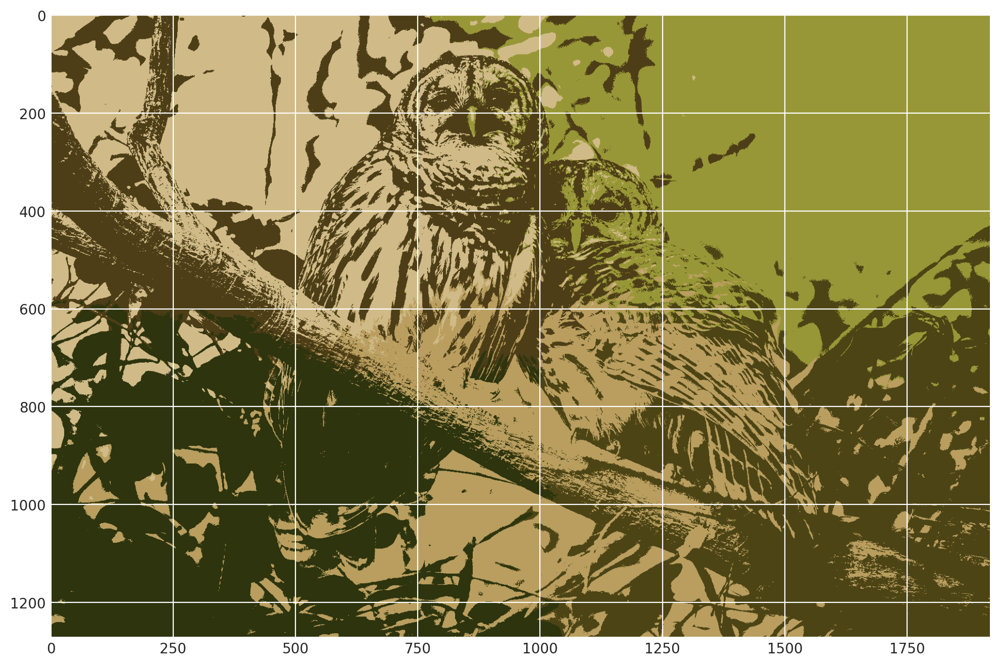

In [22]:
# 6 кластеров - мне кажется качество приемлимым исходя из идеи минимизации кол-ва кластеров 

plt.imshow(owls_1p5_k6)
plt.show()

* ducks, lambda = 0.3

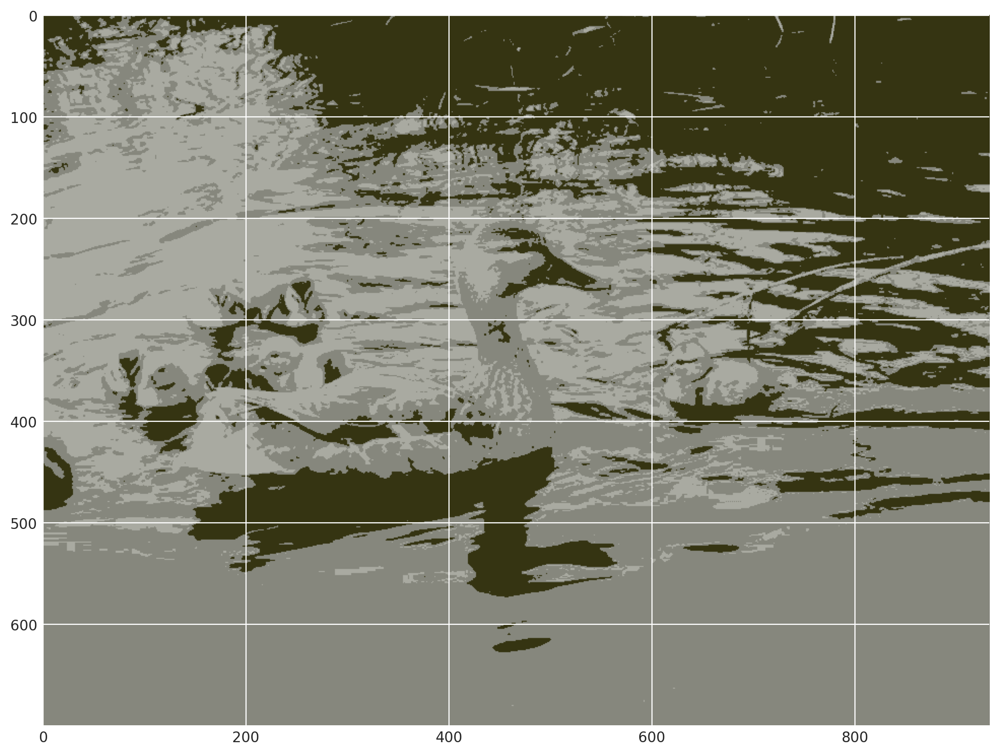

In [23]:
# 3 clusters - хоть картинка и не цветная, но 3 кластера хорошо описывают исходную фотографию

plt.imshow(duck_0p3_k3)
plt.show()

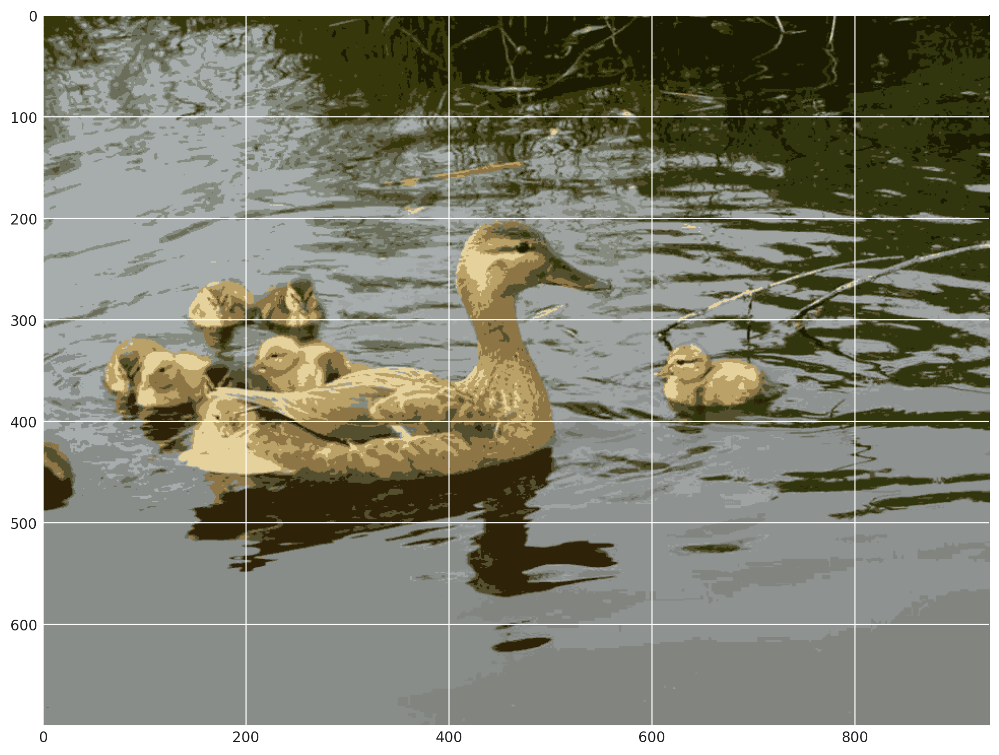

In [25]:
# 20 кластеров - для примера

plt.imshow(duck_0p3_k20)
plt.show()

___spectral segmentation___

### Задание 2.4 (1 балл)
Найдите интересную картинку милого животного и примените алгоритмы и к ней. Поэкспериментируйте с параметрами алгоритмов. Картинку нужно будет загрузить вместе с работой. Слишком большие лучше не брать - считаться будет долго. Не забудьте визуализировать!

Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

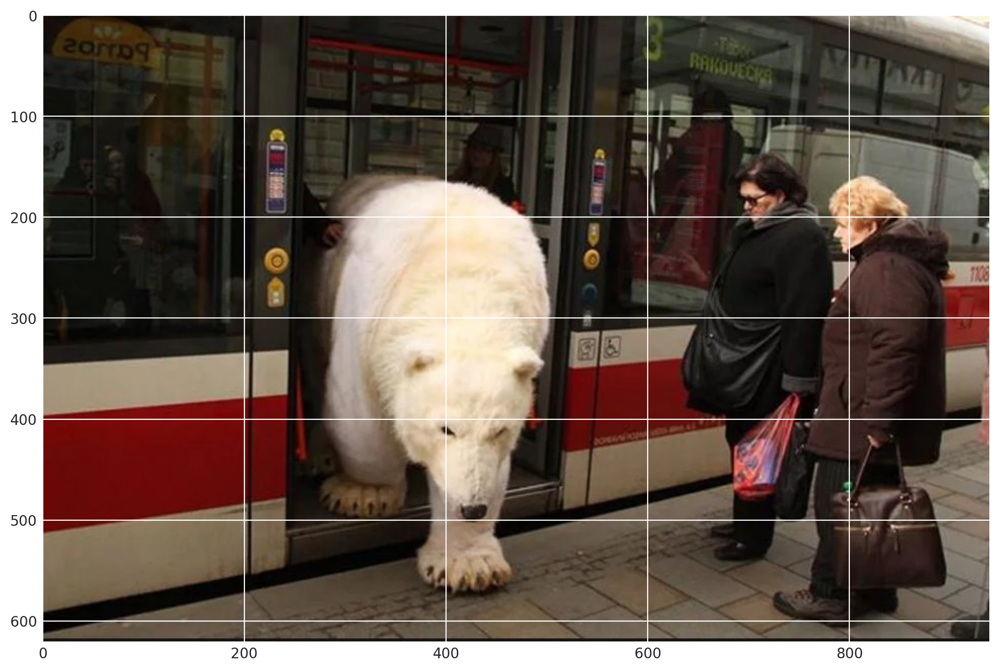

In [5]:
# 
bear = cv2.imread("/Users/dan/git_repo/movs/ml/ml/hometasks/HT5/bear.jpeg")

# Преобразование изображения из BGR в RGB
bear_rgb = cv2.cvtColor(bear, cv2.COLOR_BGR2RGB)

plt.imshow(bear_rgb)

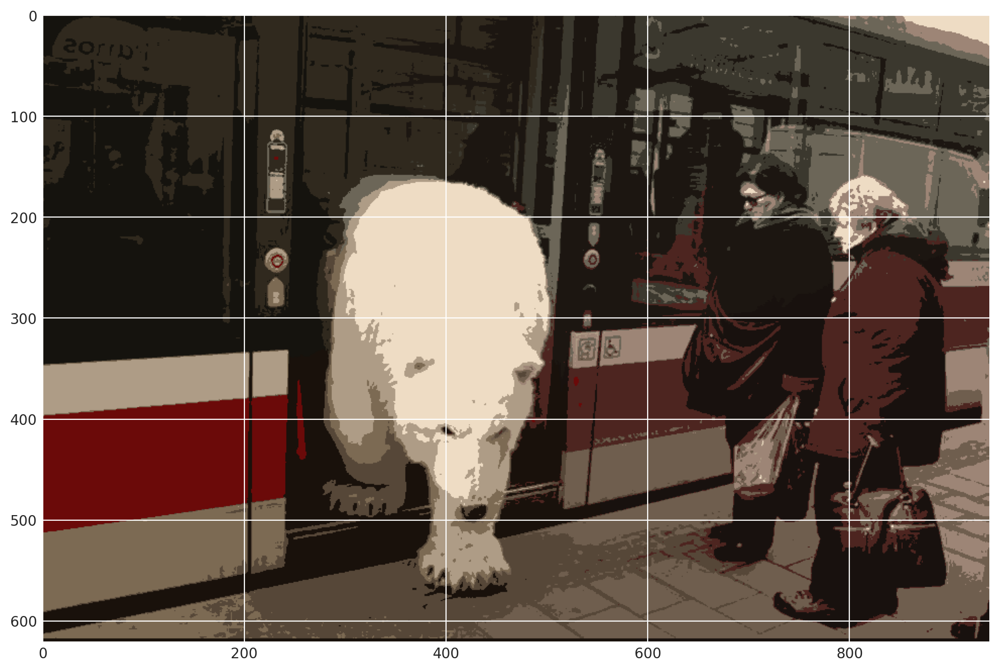

In [13]:
# lambda 0.5, clusters = 15
bear_0p5_k3 = find_components(bear_rgb, .5, 15)

plt.imshow(bear_0p5_k3)
plt.show()

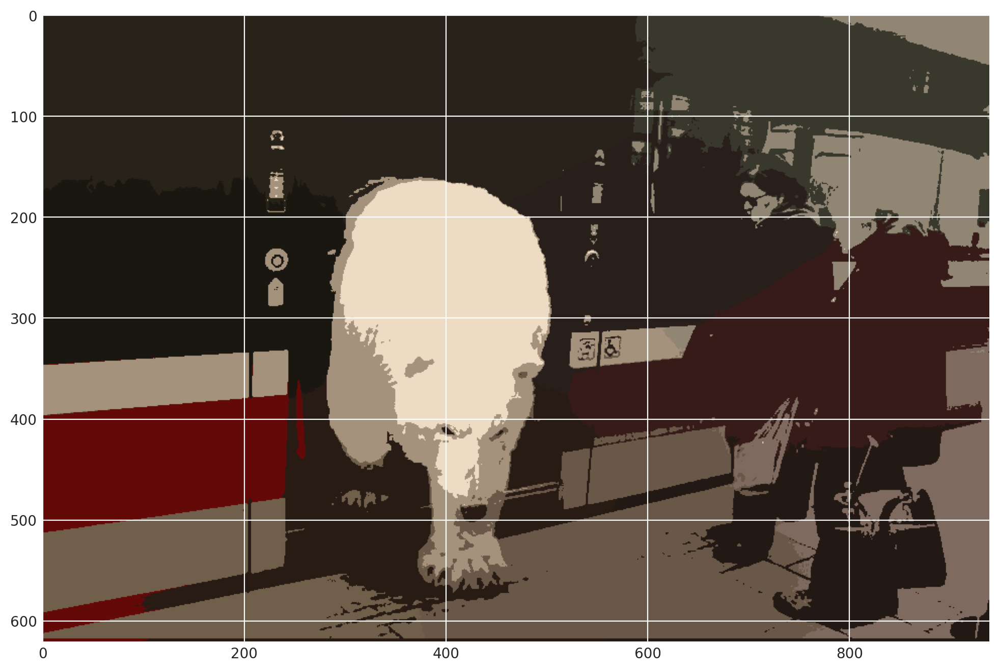

In [12]:
# lambda 1.5, clusters = 15
bear_1p5_k15 = find_components(bear_rgb, 1.5, 15)

plt.imshow(bear_1p5_k15)
plt.show()

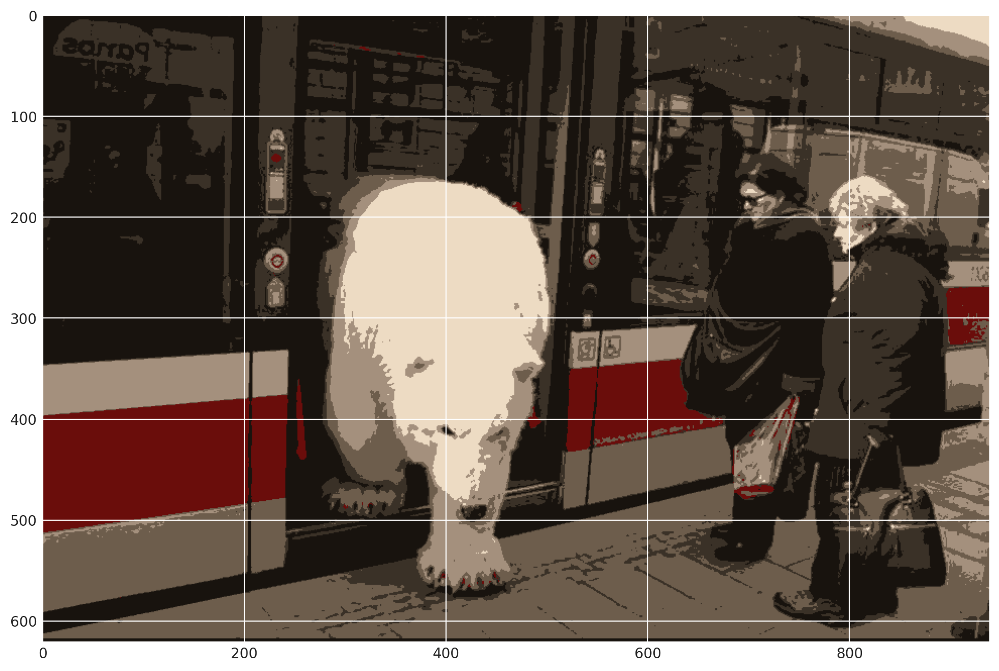

In [8]:
# lambda 0.3, clusters = 6
bear_0p3_k6 = find_components(bear_rgb, .3, 6)

plt.imshow(bear_0p3_k6)
plt.show()

*KNN*

С более низкой alpha удалось добиться лучших результатов по визуализации изображения, что интересно - даже с меньшим кол-вом кластеров (6 против 15).

Хоть я и не выделял сегменты на изображении - границы кластеров достаточно четко просматриваются, особенно при k=6 в последнем примере (так как мало цветов).